In [ ]:
!pip install geopandas


In [6]:
import os
print(os.getcwd())


C:\Users\HomePC\Documents\movendra-final-analysis


In [10]:
import pandas as pd
import geopandas as gpd

# Load SME Business List
sme_df = pd.read_csv('Free Nigeria Business List.csv')

# Load Cities with Coordinates
cities_df = pd.read_csv('ng.csv')

# Load Nigeria Road Network (correct shapefile path)
roads_gdf = gpd.read_file('hotosm_nga_roads_lines_shp/hotosm_nga_roads_lines_shp.shp')

print("✅ Roads data loaded:", roads_gdf.shape)
roads_gdf.head()


✅ Roads data loaded: (1646893, 14)


,name,name_en,highway,surface,smoothness,width,lanes,oneway,bridge,layer,source,osm_id,osm_type,geometry
0,None,None,residential,unpaved,None,None,None,None,None,None,maxar,914017285,ways_line,"LINESTRING (3.84375 7.88871, 3.84364 7.88851, ..."
1,None,None,track,None,None,None,None,None,None,None,None,1097396703,ways_line,"LINESTRING (6.59241 7.10257, 6.59252 7.10268, ..."
2,None,None,track,None,None,None,None,None,None,None,None,1097396704,ways_line,"LINESTRING (6.59313 7.10409, 6.59306 7.10394, ..."
3,None,None,track,None,None,None,None,None,None,None,None,1097396705,ways_line,"LINESTRING (6.5927 7.10376, 6.5926 7.1036, 6.5..."
4,None,None,tertiary,None,None,None,None,None,None,None,None,839845237,ways_line,"LINESTRING (6.34398 5.0486, 6.34343 5.04809, 6..."


In [26]:
print("✅ SME shape:", sme_df.shape)
print("✅ Cities shape:", cities_df.shape)
print("✅ Roads shape:", roads_gdf.shape)


✅ SME shape: (40808, 10)
✅ Cities shape: (62, 9)
✅ Roads shape: (1646893, 13)


In [3]:
# Rename for clarity
sme_df = sme_df.rename(columns={'locality': 'city', 'region': 'state'})

# Standardize city names
sme_df['city'] = sme_df['city'].str.strip().str.lower()

# Check unique values
print("Unique states:", sme_df['state'].dropna().unique())
print("Unique cities:", sme_df['city'].dropna().unique())


Unique states: ['akwa ibom state' 'lagos' 'gombe' 'osun state' 'plateau' 'fct' 'ogun'
 'kaduna' 'enugu' 'oyo' 'abia' 'oyo state' 'ondo' 'osun' 'ogun state'
 'edo' 'rivers state' 'kwara' 'akwa ibom' 'rivers' 'ekiti' 'cross river'
 'borno state' 'imo' 'kano' 'kwara state' 'imo state' 'kebbi' 'anambra'
 'katsina' 'enugu state' 'ebonyi state' 'kaduna state' 'adamawa'
 'kano state' 'kogi state' 'delta' 'ondo state' 'bayelsa' 'benue' 'sokoto'
 'bauchi' 'abia state' 'borno' 'gombe state' 'benue state' 'nassarawa'
 'bayelsa state' 'jigawa' 'sokoto state' 'yobe' 'plateau state'
 'ekiti state' 'ebonyi' 'kogi' 'niger' 'taraba' 'niger state' 'yobe state'
 'katsina state' 'taraba state' 'zamfara' 'kebbi state'
 'federal capital territory' 'nasarawa state']
Unique cities: ['uyo' 'lagos' 'ile-ife' 'jos' 'lekki' 'abuja' 'ijebu-ode' 'ikeja'
 'kaduna' 'nsukka' 'ibadan' 'isolo' 'iganmu' 'ojo' 'umuahia' 'ife' 'akure'
 'ekpoma' 'port harcourt' 'enugu' 'malete' 'ilorin' 'ajah' 'surulere'
 'calabar' 'eket' '

In [4]:
# See first 10 rows of SME data
sme_df[['name', 'industry', 'city', 'state', 'size']].head(10)


,name,industry,city,state,size
0,united ecosystem,NaN,NaN,NaN,1-10
1,joyaesthetics int’l services ltd.,NaN,NaN,NaN,1-10
2,nf aware nigeria,NaN,uyo,akwa ibom state,1-10
3,scribed it,retail,NaN,lagos,1-10
4,it's right solutions aid medicals',NaN,lagos,lagos,1-10
5,start the future initiative,NaN,NaN,gombe,1-10
6,agapely advisory,NaN,NaN,NaN,1-10
7,elenasy,higher education,NaN,NaN,1-10
8,hel_pvine,NaN,ile-ife,osun state,11-50
9,crystal impact development initiative,NaN,NaN,NaN,11-50


In [5]:
# See first 10 rows of cities
cities_df.head(100)


,city,lat,lng,country,iso2,admin_name,capital,population,population_proper
0,Lagos,6.4550,3.3841,Nigeria,NG,Lagos,minor,16637000.0,16637000.0
1,Abuja,9.0667,7.4833,Nigeria,NG,Federal Capital Territory,primary,3770000.0,107169.0
2,Ibadan,7.3964,3.9167,Nigeria,NG,Oyo,admin,3552000.0,2550593.0
3,Awka,6.2069,7.0678,Nigeria,NG,Anambra,admin,2171900.0,301657.0
4,Kano,12.0000,8.5167,Nigeria,NG,Kano,admin,2095000.0,2095000.0
...,...,...,...,...,...,...,...,...,...
57,Nchia,4.7931,7.1206,Nigeria,NG,Rivers,minor,NaN,NaN
58,Egbeda,7.3772,4.0498,Nigeria,NG,Oyo,minor,NaN,NaN
59,Ukpo,6.2141,6.9666,Nigeria,NG,Anambra,minor,NaN,NaN
60,Abagana,6.1833,6.9833,Nigeria,NG,Anambra,minor,NaN,NaN


In [11]:
# Load datasets
import pandas as pd
import geopandas as gpd

sme_df = pd.read_csv('Free Nigeria Business List.csv')
cities_df = pd.read_csv('ng.csv')
roads_gdf = gpd.read_file('hotosm_nga_roads_lines_shp/hotosm_nga_roads_lines_shp.shp')

# Rename + clean SME columns
sme_df = sme_df.rename(columns={'locality': 'city', 'region': 'state'})
sme_df['city'] = sme_df['city'].str.strip().str.lower()
cities_df['city'] = cities_df['city'].str.strip().str.lower()

# Preview
print("✅ Data loaded")
print(sme_df[['name', 'industry', 'city', 'state', 'size']].head())
print(cities_df[['city', 'lat', 'lng']].head())


✅ Data loaded
                                 name industry   city            state  size
0                    united ecosystem      NaN    NaN              NaN  1-10
1   joyaesthetics int’l services ltd.      NaN    NaN              NaN  1-10
2                    nf aware nigeria      NaN    uyo  akwa ibom state  1-10
3                          scribed it   retail    NaN            lagos  1-10
4  it's right solutions aid medicals'      NaN  lagos            lagos  1-10
     city      lat     lng
0   lagos   6.4550  3.3841
1   abuja   9.0667  7.4833
2  ibadan   7.3964  3.9167
3    awka   6.2069  7.0678
4    kano  12.0000  8.5167


In [12]:
# Merge SME data with coordinates from cities
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')

# Preview merged result
print("✅ Merged dataset shape:", sme_geo_df.shape)
print("✅ Sample with coordinates:")
sme_geo_df[['name', 'city', 'state', 'lat', 'lng']].head()


✅ Merged dataset shape: (40808, 12)
✅ Sample with coordinates:


,name,city,state,lat,lng
0,united ecosystem,NaN,NaN,NaN,NaN
1,joyaesthetics int’l services ltd.,NaN,NaN,NaN,NaN
2,nf aware nigeria,uyo,akwa ibom state,NaN,NaN
3,scribed it,NaN,lagos,NaN,NaN
4,it's right solutions aid medicals',lagos,lagos,6.455,3.3841


In [13]:
# Count SMEs that got coordinates
matched = sme_geo_df['lat'].notnull().sum()
total = sme_geo_df.shape[0]
print(f"📌 {matched} out of {total} SMEs matched with city coordinates ({matched/total:.2%})")


📌 17653 out of 40808 SMEs matched with city coordinates (43.26%)


In [14]:
unmatched = sme_geo_df[sme_geo_df['lat'].isnull()]
print(unmatched['city'].value_counts().head(20))


city
lekki        1661
yaba          523
enugu         269
ilorin        264
abeokuta      241
uyo           240
akure         232
jos           191
kaduna        186
gbagada       169
ajah          126
ikorodu       126
maryland      120
warri         116
isolo         109
calabar       101
benin          90
osogbo         88
asaba          68
ado-ekiti      65
Name: count, dtype: int64


In [15]:
# Manual fixes for top unmatched city names
city_remap = {
    'lekki': 'lagos',
    'yaba': 'lagos',
    'gbagada': 'lagos',
    'ajah': 'lagos',
    'ikorodu': 'lagos',
    'maryland': 'lagos',
    'isolo': 'lagos',
    'ado-ekiti': 'ado ekiti',
    'benin': 'benin city',
}



In [16]:
# Replace city names in SME dataset
sme_df['city'] = sme_df['city'].replace(city_remap)


In [17]:
# Re-merge after remapping
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')

# Check how many now have coordinates
matched = sme_geo_df['lat'].notnull().sum()
print(f"📌 {matched} out of {sme_df.shape[0]} SMEs matched with coordinates after remapping")


📌 20577 out of 40808 SMEs matched with coordinates after remapping


In [18]:
# Define South-West states
south_west_states = ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti']

# Filter the merged dataset
sme_sw = sme_geo_df[
    sme_geo_df['state'].str.strip().str.lower().isin(south_west_states)
]

# Preview and count
print("✅ SMEs in South-West Nigeria:", sme_sw.shape[0])
sme_sw[['name', 'city', 'state', 'lat', 'lng']].head()


✅ SMEs in South-West Nigeria: 23453


,name,city,state,lat,lng
3,scribed it,NaN,lagos,NaN,NaN
4,it's right solutions aid medicals',lagos,lagos,6.455,3.3841
11,the blue mango agency,NaN,lagos,NaN,NaN
12,webhive learning,NaN,lagos,NaN,NaN
13,truckdispatch,NaN,lagos,NaN,NaN


In [68]:
from IPython.display import display, HTML

# Scrollable table with 500px height
display(HTML(sme_sw[['name', 'city', 'state', 'lat', 'lng']].to_html(max_rows=10)))


,name,city,state,lat,lng
3,scribed it,NaN,lagos,NaN,NaN
4,it's right solutions aid medicals',lagos,lagos,6.4550,3.3841
11,the blue mango agency,NaN,lagos,NaN,NaN
12,webhive learning,NaN,lagos,NaN,NaN
13,truckdispatch,NaN,lagos,NaN,NaN
...,...,...,...,...,...
40800,unuigbe associates,NaN,lagos,NaN,NaN
40801,institute of capital market registrars,lagos,lagos,6.4550,3.3841
40802,copysurge,ibadan,oyo,7.3964,3.9167
40806,the marketing lux,NaN,lagos,NaN,NaN


In [20]:
# Show top unmatched cities in the South-West dataset
unmatched_sw = sme_sw[sme_sw['lat'].isnull()]
print("🔍 Unmatched South-West cities:")
print(unmatched_sw['city'].value_counts().head(20))




🔍 Unmatched South-West cities:
city
akure        164
abeokuta     138
osogbo        71
magodo        56
ipaja         54
ketu          52
ado ekiti     40
sangotedo     34
shomolu       32
ojodu         27
epe           23
badagri       20
mowe          19
ondo          19
ijebu-ode     18
omole         17
egba          16
iganmu        15
obalende      14
aja           14
Name: count, dtype: int64


In [21]:
city_remap_2 = {
    'magodo': 'lagos',
    'ipaja': 'lagos',
    'ketu': 'lagos',
    'sangotedo': 'lagos',
    'shomolu': 'lagos',
    'ojodu': 'lagos',
    'epe': 'lagos',
    'badagri': 'lagos',
    'mowe': 'lagos',
    'omole': 'lagos',
    'obalende': 'lagos',
    'aja': 'lagos',
    'iganmu': 'lagos',
    'ado ekiti': 'ado-ekiti',
    'ijebu-ode': 'ijebu ode'
}


In [22]:
# Apply second set of corrections
sme_df['city'] = sme_df['city'].replace(city_remap_2)


In [23]:
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')


In [27]:
sme_sw = sme_geo_df[sme_geo_df['state'].str.strip().str.lower().isin(
    ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti'])]


In [28]:
matched = sme_sw['lat'].notnull().sum()
print(f"✅ New matched SMEs in South-West: {matched} out of {sme_sw.shape[0]}")


✅ New matched SMEs in South-West: 14674 out of 23453


In [26]:
unmatched_sw = sme_sw[sme_sw['lat'].isnull()]
print(unmatched_sw['city'].value_counts().head(30))


city
akure             164
abeokuta          138
osogbo             71
ado-ekiti          40
ondo               19
ijebu ode          18
egba               16
ikosi              13
oyo                13
otta               12
ejigbo             11
agidingbi          11
obanikoro          11
awoyaya            11
mafoluku           10
ijora              10
agbara             10
ijaiye              9
amuwo               9
aguda               9
bariga              8
maroko              8
akowonjo            8
ilupeju             8
satellite town      8
iwo                 8
ogbomosho           8
ede                 7
apata ibadan        7
jibowu              7
Name: count, dtype: int64


In [29]:
manual_fixes_3 = {
    'akure': 'akure',
    'abeokuta': 'abeokuta',
    'osogbo': 'osogbo',
    'ado-ekiti': 'ado-ekiti',
    'ondo': 'ondo',
    'ijebu ode': 'ijebu ode',
    'oyo': 'oyo',
    'otta': 'ota',  # Standard spelling in cities.csv is likely "ota"
    'egba': 'abeokuta',  # Egba is a region within Abeokuta
    'ejigbo': 'lagos',
    'ikosi': 'lagos',
    'obanikoro': 'lagos',
    'agidingbi': 'lagos',
    'awoyaya': 'lagos',
    'mafoluku': 'lagos',
    'ijora': 'lagos',
    'ijaiye': 'lagos',
    'amuwo': 'lagos',
    'agbara': 'lagos',
    'aguda': 'lagos',
    'bariga': 'lagos',
    'maroko': 'lagos',
    'akowonjo': 'lagos',
    'ilupeju': 'lagos',
    'satellite town': 'lagos',
    'jibowu': 'lagos',
    'apata ibadan': 'ibadan',
    'ede': 'osogbo',  # nearby
    'iwo': 'osogbo',  # nearby
    'ogbomosho': 'oyo',  # same state
}


In [30]:
sme_df['city'] = sme_df['city'].replace(manual_fixes_3)


In [31]:
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')


In [32]:
sme_sw = sme_geo_df[sme_geo_df['state'].str.strip().str.lower().isin(
    ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti'])]


In [33]:
matched = sme_sw['lat'].notnull().sum()
print(f"✅ New matched SMEs in South-West: {matched} out of {sme_sw.shape[0]}")


✅ New matched SMEs in South-West: 14842 out of 23453


In [67]:
# Group by city and count
sme_by_city = sme_sw.groupby('city').size().reset_index(name='sme_count')

# Sort by highest
sme_by_city = sme_by_city.sort_values('sme_count', ascending=False)

# Preview top 10
sme_by_city.head(10)


,city,sme_count
68,lagos,9828
46,ikeja,2552
26,ibadan,902
54,ikoyi,674
97,surulere,482
8,akure,164
0,abeokuta,154
86,osogbo,86
5,agege,78
74,ojo,46


In [35]:
sme_by_state = sme_sw.groupby('state').size().reset_index(name='sme_count')
print(sme_by_state.sort_values('sme_count', ascending=False))


   state  sme_count
1  lagos      21402
5    oyo       1058
2   ogun        387
3   ondo        313
4   osun        220
0  ekiti         73


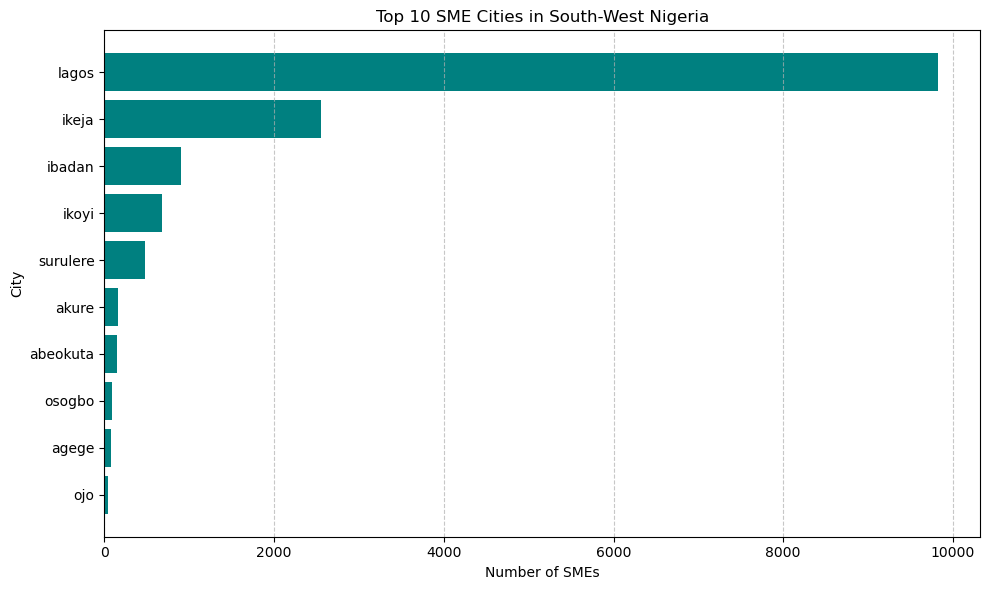

In [36]:
import matplotlib.pyplot as plt

# Make sure the data is already grouped
# (If not, re-group here)
sme_by_city = sme_sw.groupby('city').size().reset_index(name='sme_count')
sme_by_city = sme_by_city.sort_values('sme_count', ascending=False)

# Select Top 10 cities
top_10 = sme_by_city.head(10)

# Plot horizontal bar chart
plt.figure(figsize=(10, 6))
plt.barh(top_10['city'][::-1], top_10['sme_count'][::-1], color='teal')
plt.title('Top 10 SME Cities in South-West Nigeria')
plt.xlabel('Number of SMEs')
plt.ylabel('City')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


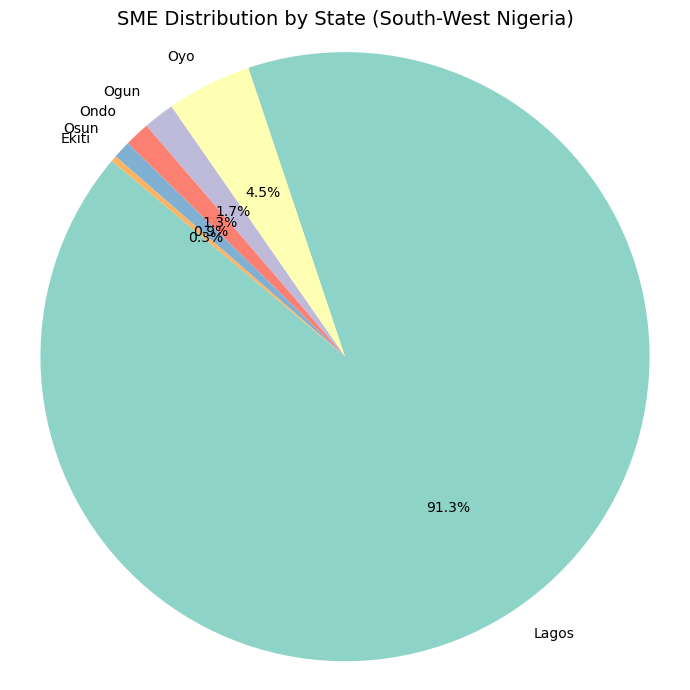

In [37]:
import matplotlib.pyplot as plt

# Group SME counts by state
sme_by_state = sme_sw.groupby('state').size().sort_values(ascending=False)

# Plot pie chart
plt.figure(figsize=(7, 7))
plt.pie(
    sme_by_state, 
    labels=sme_by_state.index.str.title(), 
    autopct='%1.1f%%', 
    startangle=140, 
    colors=plt.cm.Set3.colors
)

plt.title('SME Distribution by State (South-West Nigeria)', fontsize=14)
plt.axis('equal')  # Equal aspect ratio ensures it's a circle
plt.tight_layout()
plt.show()


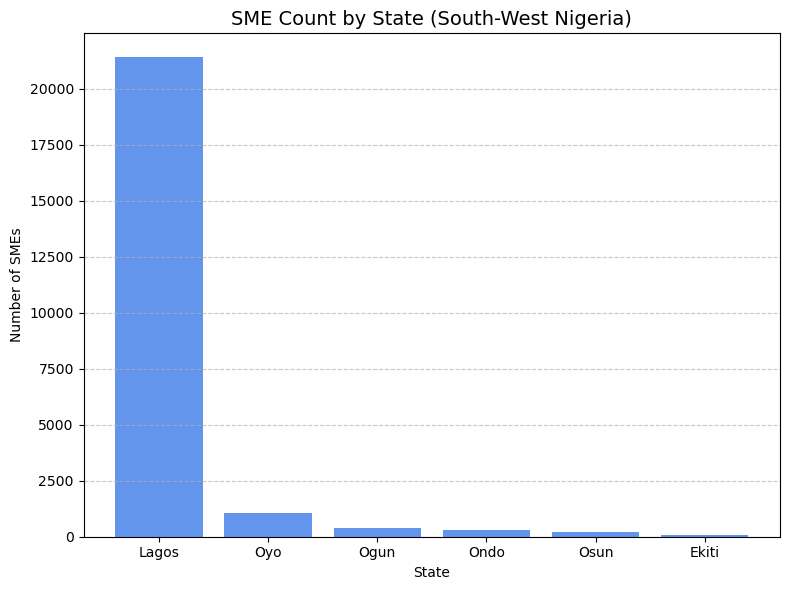

In [38]:
import matplotlib.pyplot as plt

# Group by state
sme_by_state = sme_sw.groupby('state').size().reset_index(name='sme_count')

# Sort by count
sme_by_state = sme_by_state.sort_values('sme_count', ascending=False)

# Plot
plt.figure(figsize=(8, 6))
plt.bar(sme_by_state['state'].str.title(), sme_by_state['sme_count'], color='cornflowerblue')
plt.title('SME Count by State (South-West Nigeria)', fontsize=14)
plt.xlabel('State')
plt.ylabel('Number of SMEs')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
!pip install plotly

In [39]:
import pandas as pd

# Load SME and cities data
sme_df = pd.read_csv('Free Nigeria Business List.csv')
cities_df = pd.read_csv('ng.csv')

# Clean and prepare
sme_df = sme_df.rename(columns={'locality': 'city', 'region': 'state'})
sme_df['city'] = sme_df['city'].str.strip().str.lower()
cities_df['city'] = cities_df['city'].str.strip().str.lower()

# Manual remapping (short version)
manual_fixes = {
    'lekki': 'lagos', 'yaba': 'lagos', 'ikeja': 'lagos',
    'ikoyi': 'lagos', 'surulere': 'lagos', 'ado ekiti': 'ado-ekiti',
    'ijebu-ode': 'ijebu ode', 'otta': 'ota', 'oshodi': 'lagos',
    'agege': 'lagos', 'ojo': 'lagos', 'epe': 'lagos',
    'agbara': 'lagos', 'egba': 'abeokuta', 'iwo': 'osogbo',
    'apata ibadan': 'ibadan', 'ede': 'osogbo'
}
sme_df['city'] = sme_df['city'].replace(manual_fixes)

# Merge with city coordinates
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')

# Filter South-West states
south_west_states = ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti']
sme_sw = sme_geo_df[sme_geo_df['state'].str.strip().str.lower().isin(south_west_states)]


In [40]:
import os
print(os.getcwd())


C:\Users\HomePC\Documents\movendra-final-analysis


In [41]:
import pandas as pd

# Reload your SME and cities datasets
sme_df = pd.read_csv('Free Nigeria Business List.csv')
cities_df = pd.read_csv('ng.csv')

# Clean and prepare
sme_df = sme_df.rename(columns={'locality': 'city', 'region': 'state'})
sme_df['city'] = sme_df['city'].str.strip().str.lower()
cities_df['city'] = cities_df['city'].str.strip().str.lower()

# Manual remapping (short version)
manual_fixes = {
    'lekki': 'lagos', 'yaba': 'lagos', 'ikeja': 'lagos',
    'ikoyi': 'lagos', 'surulere': 'lagos', 'ado ekiti': 'ado-ekiti',
    'ijebu-ode': 'ijebu ode', 'otta': 'ota', 'oshodi': 'lagos',
    'agege': 'lagos', 'ojo': 'lagos', 'epe': 'lagos',
    'agbara': 'lagos', 'egba': 'abeokuta', 'iwo': 'osogbo',
    'apata ibadan': 'ibadan', 'ede': 'osogbo'
}
sme_df['city'] = sme_df['city'].replace(manual_fixes)

# Merge SME data with city coordinates
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')

# Filter to South-West region
south_west_states = ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti']
sme_sw = sme_geo_df[sme_geo_df['state'].str.strip().str.lower().isin(south_west_states)]


In [42]:
import streamlit as st
import pandas as pd
import pydeck as pdk

# Load the cleaned SME dataset
@st.cache_data
def load_data():
    return pd.read_csv("southwest_smes.csv")

df = load_data()

# --- Sidebar Filters ---
st.sidebar.title("📊 Filter SMEs")
states = df['state'].dropna().unique()
selected_states = st.sidebar.multiselect("Select states", states, default=states)

filtered_df = df[df['state'].isin(selected_states)]

# --- Main App ---
st.title("📍 SME Distribution in South-West Nigeria")
st.subheader(f"{len(filtered_df)} businesses in {', '.join(selected_states)}")

# --- Interactive Map ---
st.pydeck_chart(pdk.Deck(
    map_style="mapbox://styles/mapbox/light-v9",
    initial_view_state=pdk.ViewState(
        latitude=filtered_df['lat'].mean(),
        longitude=filtered_df['lng'].mean(),
        zoom=6,
        pitch=30,
    ),
    layers=[
        pdk.Layer(
            "ScatterplotLayer",
            data=filtered_df,
            get_position='[lng, lat]',
            get_color='[0, 128, 255, 160]',
            get_radius=300,
            pickable=True
        )
    ],
    tooltip={"text": "{name}\n{city}, {state}"}
))

# --- Chart ---
st.subheader("Top Cities by SME Count")
city_counts = filtered_df['city'].value_counts().head(10)
st.bar_chart(city_counts)


2025-07-01 06:49:23.471 WARNING streamlit.runtime.caching.cache_data_api: No runtime found, using MemoryCacheStorageManager
2025-07-01 06:49:24.614 
  command:

    streamlit run C:\Users\HomePC\anaconda3\Lib\site-packages\ipykernel_launcher.py [ARGUMENTS]
2025-07-01 06:49:24.763 No runtime found, using MemoryCacheStorageManager


DeltaGenerator()

In [11]:
code = '''
import streamlit as st
import pandas as pd
import pydeck as pdk

# Load the cleaned SME dataset
@st.cache_data
def load_data():
    return pd.read_csv("southwest_smes.csv")

df = load_data()

# --- Sidebar Filters ---
st.sidebar.title("Filter SMEs")
states = df['state'].dropna().unique()
selected_states = st.sidebar.multiselect("Select states", states, default=states)

filtered_df = df[df['state'].isin(selected_states)]

# --- Main App ---
st.title("SME Distribution in South-West Nigeria")
st.subheader(f"{len(filtered_df)} businesses in {', '.join(selected_states)}")

# --- Interactive Map ---
st.pydeck_chart(pdk.Deck(
    map_style="mapbox://styles/mapbox/light-v9",
    initial_view_state=pdk.ViewState(
        latitude=filtered_df['lat'].mean(),
        longitude=filtered_df['lng'].mean(),
        zoom=6,
        pitch=30,
    ),
    layers=[
        pdk.Layer(
            "ScatterplotLayer",
            data=filtered_df,
            get_position='[lng, lat]',
            get_color='[0, 128, 255, 160]',
            get_radius=300,
            pickable=True
        )
    ],
    tooltip={"text": "{name}\\n{city}, {state}"}
))

# --- Chart ---
st.subheader("Top Cities by SME Count")
city_counts = filtered_df['city'].value_counts().head(10)
st.bar_chart(city_counts)
'''

# Save the code as a Python file with UTF-8 encoding
with open("sme_app.py", "w", encoding="utf-8") as f:
    f.write(code)

print("✅ sme_app.py file created successfully.")


✅ sme_app.py file created successfully.


In [14]:
selected_states = st.sidebar.multiselect("Select states", states, default=states)
filtered_df = df[df['state'].isin(selected_states)]


In [15]:
import pandas as pd

df = pd.read_csv("southwest_smes.csv")
print("Unique states in your file:")
print(df['state'].dropna().str.strip().str.lower().unique())


Unique states in your file:
['lagos' 'oyo' 'ondo' 'ogun' 'osun']


In [60]:
# Filter to Oyo SMEs
oyo_df = sme_sw[sme_sw['state'] == 'oyo']

# Count total vs geocoded
total = len(oyo_df)
matched = oyo_df['lat'].notnull().sum()

print(f"🔍 Total SMEs in Oyo: {total}")
print(f"📌 Geocoded SMEs (with lat/lng): {matched}")


🔍 Total SMEs in Oyo: 1058
📌 Geocoded SMEs (with lat/lng): 929


In [59]:
# Fix state names
sme_df['state'] = sme_df['state'].str.strip().str.lower()

state_fix = {
    'ekiti state': 'ekiti',
    'ondo state': 'ondo',
    'osun state': 'osun',
    'oyo state': 'oyo',
    'lagos state': 'lagos',
    'ogun state': 'ogun'
}

sme_df['state'] = sme_df['state'].replace(state_fix)


In [57]:
cities_df = pd.read_csv("ng.csv")
cities_df['city'] = cities_df['city'].str.strip().str.lower()
sme_df['city'] = sme_df['city'].str.strip().str.lower()

# Merge with coordinates
sme_geo_df = pd.merge(sme_df, cities_df[['city', 'lat', 'lng']], on='city', how='left')

# Filter again for South-West region
south_west_states = ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti']
sme_sw = sme_geo_df[sme_geo_df['state'].isin(south_west_states)]

# Export again to update your Streamlit data
sme_sw.to_csv("southwest_smes.csv", index=False)
print("✅ Cleaned and re-saved with Ekiti + Oyo fixes.")


✅ Cleaned and re-saved with Ekiti + Oyo fixes.


In [43]:
import pandas as pd

# Load the cleaned SME dataset used in your Streamlit app
df = pd.read_csv("southwest_smes.csv")

# Confirm it's loaded
print("✅ Loaded SMEs:", len(df))


✅ Loaded SMEs: 24294


In [67]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# ✅ Load the same full SME dataset used by Streamlit
df = pd.read_csv("southwest_smes.csv")

# Drop missing coordinate entries
df = df.dropna(subset=['lat', 'lng'])

# Just in case — ensure we're working only with SW states
sw_states = ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti']
df = df[df['state'].isin(sw_states)]

print("✅ SMEs mapped:", len(df))  # Should say 24,294

# Create base map
center_lat = df['lat'].mean()
center_lng = df['lng'].mean()
m = folium.Map(location=[center_lat, center_lng], zoom_start=7, tiles='CartoDB Positron')

# Marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add markers
for _, row in df.iterrows():
    folium.Marker(
        location=[row['lat'], row['lng']],
        popup=f"{row['name']} ({row['city'].title()}, {row['state'].title()})",
        icon=folium.Icon(color="blue", icon="briefcase", prefix="fa")
    ).add_to(marker_cluster)

# Show map
m


✅ SMEs mapped: 13687


In [49]:
sw_states = ['lagos', 'ogun', 'oyo', 'osun', 'ondo', 'ekiti']
df = df[df['state'].isin(sw_states)]
print("📍 SMEs in South-West Nigeria:", len(df))


📍 SMEs in South-West Nigeria: 11757


<Axes: title={'center': 'SMEs per State'}, xlabel='state'>

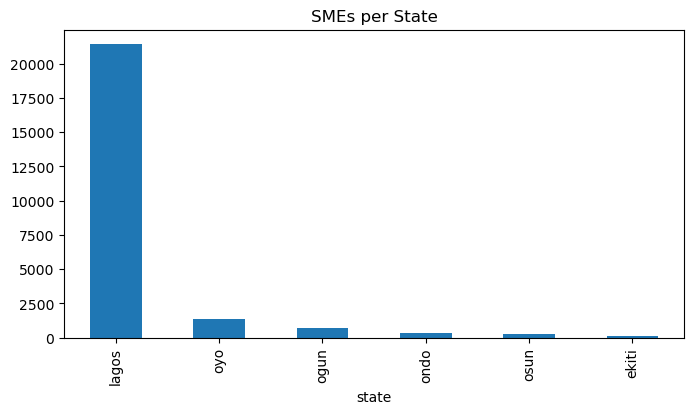

In [61]:
df['state'].value_counts().plot(kind='bar', title='SMEs per State', figsize=(8,4))


In [62]:
df['city'].value_counts().head(10)


city
lagos       6459
ikeja       2552
lekki       1661
ibadan      1186
ikoyi        674
yaba         520
surulere     482
abeokuta     241
akure        232
gbagada      169
Name: count, dtype: int64

In [51]:
df = df.dropna(subset=['lat', 'lng'])


In [52]:
missing = df[df['lat'].isna() | df['lng'].isna()]
print(f"❌ Missing coordinates: {len(missing)} SMEs")


❌ Missing coordinates: 0 SMEs


In [53]:
print("Missing by state:")
print(missing['state'].value_counts())


Missing by state:
Series([], Name: count, dtype: int64)


In [54]:
import pandas as pd

df = pd.read_csv("southwest_smes.csv")
print(df.shape)
print(df.columns)
print(df['state'].unique())
print(df[['lat', 'lng']].isnull().sum())


(24294, 12)
Index(['country', 'founded', 'id', 'industry', 'linkedin_url', 'city', 'name',
       'state', 'size', 'website', 'lat', 'lng'],
      dtype='object')
['lagos' 'osun' 'ogun' 'oyo' 'ondo' 'ekiti']
lat    12537
lng    12537
dtype: int64


In [55]:
south_west = ['lagos', 'oyo', 'ogun', 'osun', 'ondo', 'ekiti']
df['state'] = df['state'].str.strip().str.lower()
df_sw = df[df['state'].isin(south_west)]
print("✅ Total South-West SMEs:", len(df_sw))
print(df_sw['state'].value_counts())


✅ Total South-West SMEs: 24294
state
lagos    21402
oyo       1388
ogun       732
ondo       381
osun       293
ekiti       98
Name: count, dtype: int64


In [64]:
import pandas as pd
df = pd.read_csv("southwest_smes.csv")
print(df.shape)
print(df['state'].value_counts())


(23453, 12)
state
lagos    21402
oyo       1058
ogun       387
ondo       313
osun       220
ekiti       73
Name: count, dtype: int64
